In [1]:
import sys
!{sys.executable} --version

Python 3.10.6


## Setup TAO mounts.

Since the TAO Toolkit abstracts operations into Docker containers, we need to specify how the Docker containers can access outside data. We do this with a file called `~/.tao_mounts.json` where we specify the mapping from "source" directories to "destination" directories. See more here: https://docs.nvidia.com/tao/tao-toolkit/text/tao_launcher.html#running-the-launcher

In [2]:
import os

%env KEY=tlt_encode
%env NUM_GPUS=1
%env USER_EXPERIMENT_DIR=/workspace/project/detectnet_v2
%env DATA_DOWNLOAD_DIR=/workspace/project/data

# Set this path if you don't run the notebook from the samples directory.
# %env NOTEBOOK_ROOT=~/tao-samples/detectnet_v2

# Please define this local project directory that needs to be mapped to the TAO docker session.
# The dataset expected to be present in $LOCAL_PROJECT_DIR/data, while the results for the steps
# in this notebook will be stored at $LOCAL_PROJECT_DIR/detectnet_v2
# !PLEASE MAKE SURE TO UPDATE THIS PATH!.

os.environ["LOCAL_PROJECT_DIR"] = "/home/antonio/Desktop/pfe/tao/project/"

os.environ["LOCAL_DATA_DIR"] = os.path.join(
    os.getenv("LOCAL_PROJECT_DIR", os.getcwd()),
    "Auto-Robert-2"
)
os.environ["LOCAL_EXPERIMENT_DIR"] = os.path.join(
    os.getenv("LOCAL_PROJECT_DIR", os.getcwd()),
    "detectnet_v2"
)

# Make the experiment directory 
! mkdir -p $LOCAL_EXPERIMENT_DIR

env: KEY=tlt_encode
env: NUM_GPUS=1
env: USER_EXPERIMENT_DIR=/workspace/project/detectnet_v2
env: DATA_DOWNLOAD_DIR=/workspace/project/data


In [3]:
# Mapping up the local directories to the TAO docker.
import json
mounts_file = os.path.expanduser("~/.tao_mounts.json")

# Define the dictionary with the mapped drives
drive_map = {
    "Mounts": [
        # Mapping the data directory
        {
            "source": os.environ["LOCAL_PROJECT_DIR"],
            "destination": "/workspace/project"
        },
    ],
    "DockerOptions": {
        # preserving the same permissions with the docker as in host machine.
        "user": "{}:{}".format(os.getuid(), os.getgid())
    }
}

# Writing the mounts file.
with open(mounts_file, "w") as mfile:
    json.dump(drive_map, mfile, indent=4)

In [4]:
!cat ~/.tao_mounts.json

{
    "Mounts": [
        {
            "source": "/home/antonio/Desktop/pfe/tao/project/",
            "destination": "/workspace/project"
        }
    ],
    "DockerOptions": {
        "user": "1000:1000"
    }
}

In [5]:
# *Replace this cell with your own snippet from Roboflow Export.*

# from roboflow import Roboflow
# rf = Roboflow(api_key="Kj7IpsRDsn3rStIiSpwR")
# project = rf.workspace("insper").project("auto-robert")
# dataset = project.version(2).download("coco")

In [13]:
# Specify RF COCO dataset details

dataset_config = """
coco_config {
  root_directory_path: "/workspace/project/Auto-Robert-2"
  img_dir_names: ["test", "train", "valid"]
  annotation_files: [ "test/_annotations.coco.json", "train/_annotations.coco.json", "valid/_annotations.coco.json"]
  num_partitions: 3
  num_shards: [1, 72, 2]
}
image_directory_path: "/workspace/project/Auto-Robert-2"
"""

# write the dataset config to a JSON file
file_object = open('./Auto-Robert-2/coco_config.json', 'w')
file_object.write(dataset_config)
file_object.close()
!cat ./Auto-Robert-2/coco_config.json


coco_config {
  root_directory_path: "/workspace/project/Auto-Robert-2"
  img_dir_names: ["test", "train", "valid"]
  annotation_files: [ "test/_annotations.coco.json", "train/_annotations.coco.json", "valid/_annotations.coco.json"]
  num_partitions: 3
  num_shards: [1, 72, 2]
}
image_directory_path: "/workspace/project/Auto-Robert-2"


In [14]:
!tao bpnet run ls /workspace/project/Auto-Robert-2/test

2022-11-07 16:43:36,281 [INFO] root: Registry: ['nvcr.io']
2022-11-07 16:43:36,351 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.5-py3
20221025_184152_jpg.rf.6d768dc0caad3ce51286b6a6b17c3a97.jpg
20221025_184210_jpg.rf.f12eea9c932888b75a7e47aa2b029be9.jpg
20221025_184242_jpg.rf.4ac16cbff6fda9d47b279adaafe322ca.jpg
20221025_184248_jpg.rf.a6412a4eab7a41b9f9fa027438010649.jpg
20221025_184341_jpg.rf.7274e8186d1241f563975b1e26c7227c.jpg
20221025_184344_jpg.rf.144312315000e5e83248878891d0dd43.jpg
20221025_184443_jpg.rf.82e5ab93f25feee815d6ceb39a31a520.jpg
20221025_191054_jpg.rf.f317d7861e7ac4433f051ca8a6490b9a.jpg
20221025_191119_jpg.rf.c9c9d5788468f9eef75a893d03ce96ea.jpg
20221025_191129_jpg.rf.3a23916702f10b766c73f07f6527b829.jpg
20221025_191147_jpg.rf.16ffec06673dc8b0b7c8a96500ba5788.jpg
20221025_191227_jpg.rf.6d586e4e7b46268c1f458a75b58b1b9c.jpg
20221025_191248_jpg.rf.a7e8baf86080af154db89f5363d81dbe.

In [15]:
# Convert to TFRecords. We'll move the TFRecord files to a custom directory
# in the next cell.

!tao detectnet_v2 dataset_convert -d "/workspace/project/coco_config.json" --gpu_index 0 -o "/workspace/project/output.tfrecords"

2022-11-07 16:43:40,493 [INFO] root: Registry: ['nvcr.io']
2022-11-07 16:43:40,562 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-8wcszfls because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using TensorFlow backend.
2022-11-07 19:43:47,485 [INFO] iva.detectnet_v2.dataio.build_converter: Instantiating a coco converter
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
load

In [18]:
!mkdir output_tfrecords

In [19]:

!mv output.tfrecords* output_tfrecords

In [20]:
# Download NVIDIA pretrained Resnet18 model.

# !wget https://api.ngc.nvidia.com/v2/models/nvidia/tao/pretrained_object_detection/versions/resnet18/files/resnet_18.hdf5 ./project/resnet_18.hdf5

--2022-11-07 16:45:18--  https://api.ngc.nvidia.com/v2/models/nvidia/tao/pretrained_object_detection/versions/resnet18/files/resnet_18.hdf5
Resolving api.ngc.nvidia.com (api.ngc.nvidia.com)... 54.215.161.153, 54.177.25.114
Connecting to api.ngc.nvidia.com (api.ngc.nvidia.com)|54.215.161.153|:443... connected.
HTTP request sent, awaiting response... 302 
Location: https://prod-model-registry-ngc-bucket.s3.us-west-2.amazonaws.com/org/nvidia/team/tao/models/pretrained_object_detection/versions/resnet18/files/resnet_18.hdf5?response-content-disposition=attachment%3B%20filename%3D%22resnet_18.hdf5%22&response-content-type=application%2Foctet-stream&X-Amz-Security-Token=IQoJb3JpZ2luX2VjEDsaCXVzLXdlc3QtMiJGMEQCIE4rEo%2F0iSG4xecHcOge0jPFl1CSZjHmCb84TUQ%2Bn455AiBg8xyCdmnoz4hkvtNfv0UwTx4AVdYeM90aLxnFA2jYRSrMBAg0EAQaDDc4OTM2MzEzNTAyNyIMo8xEZD0Ouys%2BRVkkKqkEGe6X0YfrzOkl5t6zWvf5bQNOMDB6UMh4uMG%2Brxm8R6rM0ysBrh6fJwhHG5bSxk68Of%2F2%2B8xhnguRYONlelTgJSNiiM37t1%2FLUbbTTgd75wByevPfryL%2FldNb81LkPFZfSR%

In [22]:
# !ngc registry model list nvidia/tao/pretrained_detectnet_v2:*

/bin/bash: line 1: ngc: command not found


In [48]:
# Train our model

!tao detectnet_v2 train -e "/workspace/project/experiment_spec.json" -r "/workspace/project/resnet18_unpruned" -k "roboflow" --use_amp

# Logs will be saved to the "run1" directory, including a CSV of 
# training accuracy over time.

2022-11-07 18:08:19,523 [INFO] root: Registry: ['nvcr.io']
2022-11-07 18:08:19,576 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-48up2tcy because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using TensorFlow backend.

2022-11-07 21:08:24,495 [WARNING] tensorflow: From /root/.cache/bazel/_bazel_root/b770f990bb7b9e2db5771981fb3a38b4/execroot/ai_infra/bazel-out/k8-fastbuild/bin/magnet/packages/iva/build_whe

In [51]:
!tao detectnet_v2 evaluate -e /workspace/project/experiment_spec.json\
                           -m /workspace/project/resnet18_unpruned/weights/model.tlt \
                           -k "roboflow"

2022-11-07 18:45:36,003 [INFO] root: Registry: ['nvcr.io']
2022-11-07 18:45:36,055 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-1ku2kppr because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using TensorFlow backend.

2022-11-07 21:45:41,062 [WARNING] tensorflow: From /root/.cache/bazel/_bazel_root/b770f990bb7b9e2db5771981fb3a38b4/execroot/ai_infra/bazel-out/k8-fastbuild/bin/magnet/packages/iva/build_whe

In [3]:
!tao detectnet_v2 prune \
                  -m /workspace/project/resnet18_unpruned/weights/model.tlt \
                  -o /workspace/project/resnet18_pruned/model_pruned.tlt \
                  -eq union \
                  -pth 0.0000052 \
                  -k "roboflow"

2022-11-07 21:31:38,027 [INFO] root: Registry: ['nvcr.io']
2022-11-07 21:31:38,085 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-mz_vrp63 because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using TensorFlow backend.
2022-11-08 00:31:44,839 [INFO] modulus.pruning.pruning: Exploring graph for retainable indices
2022-11-08 00:31:45,230 [INFO] modulus.pruning.pruning: Pruning model and appending pruned node

In [14]:
!tao detectnet_v2 train -e /workspace/project/detectnet_v2_retrain_resnet18.txt \
                        -r /workspace/project/experiment_dir_retrain \
                        -k "roboflow" \
                        -n resnet18_detector_pruned 

2022-11-08 01:44:55,501 [INFO] root: Registry: ['nvcr.io']
2022-11-08 01:44:55,547 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-ik8k8juz because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using TensorFlow backend.

2022-11-08 04:45:00,411 [WARNING] tensorflow: From /root/.cache/bazel/_bazel_root/b770f990bb7b9e2db5771981fb3a38b4/execroot/ai_infra/bazel-out/k8-fastbuild/bin/magnet/packages/iva/build_whe

In [15]:
!tao detectnet_v2 evaluate -e /workspace/project/detectnet_v2_retrain_resnet18.txt \
                           -m /workspace/project/experiment_dir_retrain/weights/resnet18_detector_pruned.tlt \
                           -k "roboflow"

2022-11-08 02:32:24,500 [INFO] root: Registry: ['nvcr.io']
2022-11-08 02:32:24,546 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-zed3mduu because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using TensorFlow backend.

2022-11-08 05:32:29,538 [WARNING] tensorflow: From /root/.cache/bazel/_bazel_root/b770f990bb7b9e2db5771981fb3a38b4/execroot/ai_infra/bazel-out/k8-fastbuild/bin/magnet/packages/iva/build_whe

In [16]:
!tao detectnet_v2 inference -e /workspace/project/detectnet_v2_inference.txt \
                            -o /workspace/project/tlt_infer_testing \
                            -i /workspace/project/Auto-Robert-2/test \
                            -k "roboflow"

2022-11-08 02:33:40,524 [INFO] root: Registry: ['nvcr.io']
2022-11-08 02:33:40,570 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-b6nm_wxe because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
INFO: Merging specification from /workspace/project/detectnet_v2_inference.txt
INFO: Overlain images will be saved in the output path.
INFO: Constructing inferencer




INFO: Loading model f

In [67]:
# Simple grid visualizer
%matplotlib inline
import matplotlib.pyplot as plt
import os
from math import ceil
valid_image_ext = ['.jpg', '.png', '.jpeg', '.ppm']

def visualize_images(image_dir, num_cols=4, num_images=10):
    output_path = os.path.join("/home/antonio/Desktop/pfe/tao/project/", image_dir)
    num_rows = int(ceil(float(num_images) / float(num_cols)))
    f, axarr = plt.subplots(num_rows, num_cols, figsize=[80,30])
    f.tight_layout()
    a = [os.path.join(output_path, image) for image in os.listdir(output_path) 
         if os.path.splitext(image)[1].lower()
         in valid_image_ext]
    for idx, img_path in enumerate(a[:num_images]):
        col_id = idx % num_cols
        row_id = idx // num_cols
        img = plt.imread(img_path)
        axarr[row_id, col_id].imshow(img) 

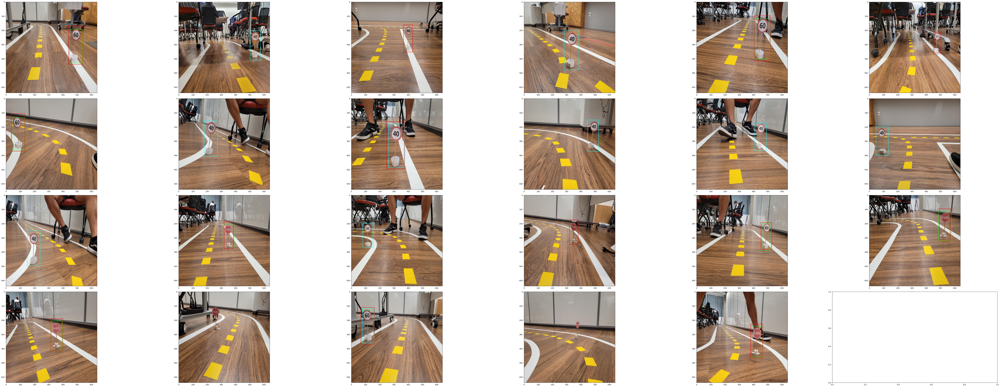

In [23]:
OUTPUT_PATH = 'tlt_infer_testing/images_annotated' # relative path from $USER_EXPERIMENT_DIR.
COLS = 6 # number of columns in the visualizer grid.
IMAGES = 23 # number of images to visualize.

visualize_images(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)

In [1]:
!tao detectnet_v2 calibration_tensorfile -e /workspace/project/detectnet_v2_retrain_resnet18.txt \
                                         -m 10 \
                                         -o /workspace/project/experiment_dir_final/calibration.tensor

2022-11-08 14:28:52,565 [INFO] root: Registry: ['nvcr.io']
2022-11-08 14:28:52,624 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-wrkvs_6j because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using TensorFlow backend.
2022-11-08 17:29:00,538 [INFO] __main__: This method is soon to be deprecated. Please use the -e option in the export command to instantiate the dataloader and generate samples for calibrati

In [2]:
!rm -rf /workspace/project/experiment_dir_final/resnet18_detector.etlt
!rm -rf /workspace/project/experiment_dir_final/calibration.bin
!tao detectnet_v2 export \
                  -m /workspace/project/experiment_dir_retrain/weights/resnet18_detector_pruned.tlt \
                  -o /workspace/project/experiment_dir_final/resnet18_detector.etlt \
                  -k "roboflow"  \
                  --cal_data_file /workspace/project/experiment_dir_final/calibration.tensor \
                  --data_type int8 \
                  --batches 10 \
                  --batch_size 4 \
                  --max_batch_size 4\
                  --engine_file /workspace/project/experiment_dir_final/resnet18_detector.trt.int8 \
                  --cal_cache_file /workspace/project/experiment_dir_final/calibration.bin \
                  --verbose

2022-11-08 14:31:43,037 [INFO] root: Registry: ['nvcr.io']
2022-11-08 14:31:43,094 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-3h1g2yuh because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
2022-11-08 17:31:50,348 [INFO] iva.common.export.keras_exporter: Using input nodes: ['input_1']
2022-11-08 17:31:50,348 [INFO] iva.common.export.keras_exporter: Using output nodes: ['output_

In [9]:
!ngc registry resource download-version nvidia/tao/tao-converter:v3.21.11_trt7.1_agx --dest /home/antonio/Desktop/pfe/tao/project

/bin/bash: line 1: ngc: command not found


In [60]:
!tao bpnet run cat /usr/local/lib/python3.6/dist-packages/tensorrt/__init__.py

2022-11-08 19:23:53,571 [INFO] root: Registry: ['nvcr.io']
2022-11-08 19:23:53,620 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.5-py3
#
# Copyright (c) 2021, NVIDIA CORPORATION. All rights reserved.
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#     http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.
#

import ctypes
import glob
import os
import sys
import warnings


def try_load(library):
    try:
        ctypes.CDLL(library)
    except OSError:
        pass


#

In [61]:
!tao bpnet run cat /usr/include/cudnn_version.h

2022-11-08 19:23:57,149 [INFO] root: Registry: ['nvcr.io']
2022-11-08 19:23:57,198 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.5-py3
/*
 * Copyright 2019 NVIDIA Corporation.  All rights reserved.
 *
 * NOTICE TO LICENSEE:
 *
 * This source code and/or documentation ("Licensed Deliverables") are
 * subject to NVIDIA intellectual property rights under U.S. and
 * international Copyright laws.
 *
 * These Licensed Deliverables contained herein is PROPRIETARY and
 * CONFIDENTIAL to NVIDIA and is being provided under the terms and
 * conditions of a form of NVIDIA software license agreement by and
 * between NVIDIA and Licensee ("License Agreement") or electronically
 * accepted by Licensee.  Notwithstanding any terms or conditions to
 * the contrary in the License Agreement, reproduction or disclosure
 * of the Licensed Deliverables to any third party without the express
 * written consent of NVIDIA 

In [1]:
!tao converter /workspace/project/experiment_dir_final/resnet18_detector.etlt \
                   -k "roboflow" \
                    -c /workspace/project/experiment_dir_final/calibration.bin \
                   -o output_cov/Sigmoid,output_bbox/BiasAdd \
                   -d 3,640,640 \
                   -i nchw \
                   -t int8 \
                   -e /workspace/project/experiment_dir_final/resnet18_int8_detector.engine

2022-11-09 14:01:09,657 [INFO] root: Registry: ['nvcr.io']
2022-11-09 14:01:09,709 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.5-py3
[INFO] [MemUsageChange] Init CUDA: CPU +473, GPU +0, now: CPU 484, GPU 273 (MiB)
[INFO] [MemUsageSnapshot] Begin constructing builder kernel library: CPU 484 MiB, GPU 273 MiB
[INFO] [MemUsageSnapshot] End constructing builder kernel library: CPU 638 MiB, GPU 315 MiB
[INFO] Reading Calibration Cache for calibrator: EntropyCalibration2
[INFO] Generated calibration scales using calibration cache. Make sure that calibration cache has latest scales.
[INFO] To regenerate calibration cache, please delete the existing one. TensorRT will generate a new calibration cache.
[WARNING] Missing scale and zero-point for tensor output_bbox/bias, expect fall back to non-int8 implementation for any layer consuming or producing given tensor
[WARNING] Missing scale and zero-point for te

In [65]:
!tao detectnet_v2 inference -e /workspace/project/detectnet_v2_inference_etlt.txt \
                            -o /workspace/project/etlt_infer_testing \
                            -i /workspace/project/Auto-Robert-2/test \
                            -k "roboflow"

2022-11-08 19:51:48,373 [INFO] root: Registry: ['nvcr.io']
2022-11-08 19:51:48,429 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-wxl0uox_ because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
INFO: Merging specification from /workspace/project/detectnet_v2_inference_etlt.txt
INFO: Overlain images will be saved in the output path.
INFO: Constructing inferencer
INFO: Reading from e

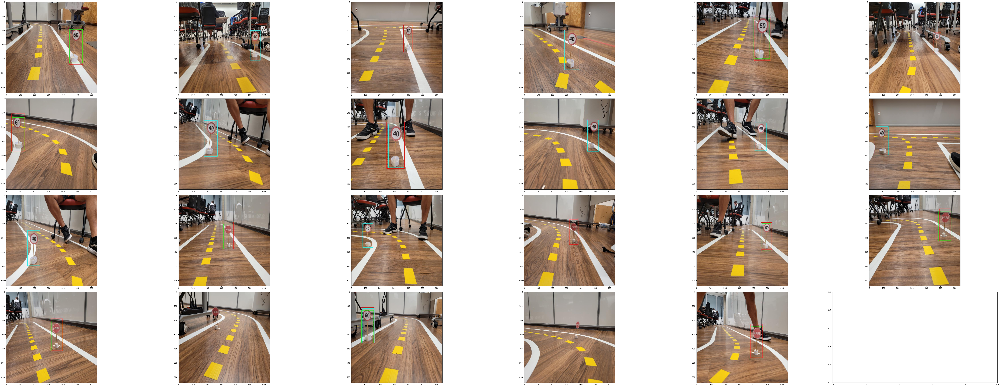

In [68]:
OUTPUT_PATH = 'etlt_infer_testing/images_annotated' # relative path from $USER_EXPERIMENT_DIR.
COLS = 6 # number of columns in the visualizer grid.
IMAGES = 23 # number of images to visualize.

visualize_images(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)